In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os
from tabulate import tabulate
import warnings
warnings.filterwarnings("ignore")

## Question 5

#### Function Definitions

In [2]:
def convert_to_gray_scale(rgb_img):
    r, g, b = rgb_img[:,:,0], rgb_img[:,:,1], rgb_img[:,:,2]
    gray_img = 0.2989 * r + 0.5870 * g + 0.1140 * b
    return gray_img

In [3]:
def apply_PCA(gray_img, random = False):
    U , S, VT = np.linalg.svd(gray_img) 
    N = S.shape[0]
    
    if random == False:
        n_pc = list(map(lambda x: int(x*N), [0.10, 0.25, 0.50]))
        reconst_images = []
        for n in n_pc:  
            U_new = U[:,:n]
            Sigma_new = np.diag(S[:n])
            V = VT.T
            V_new = V[:,:n]
            img_transfom = np.matmul(U_new,Sigma_new)
            reconst_images.append(np.matmul(U_new,np.matmul(Sigma_new,V_new.T)).reshape(np.shape(gray_img)))
        return reconst_images
    
    else:
        order = list(range(N))
        np.random.shuffle(order)
        
        U_new = U[:,order[:int(0.10*N)]]
        Sigma_new = np.diag(S[order[:int(0.10*N)]])
        V = VT.T
        V_new = V[:,order[:int(0.10*N)]]
        img_transfom = np.matmul(U_new,Sigma_new)
        reconst_image = np.matmul(U_new,np.matmul(Sigma_new,V_new.T)).reshape(np.shape(gray_img))
        return reconst_image
    


#### Loading the image dataset

In [4]:
coloured_images = []
folder = 'Rectangular Images'
for file in os.listdir(folder):
    img = plt.imread(os.path.join(folder,file))
    coloured_images.append(img)

#### Part (a)

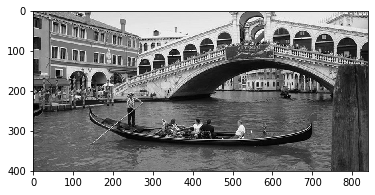

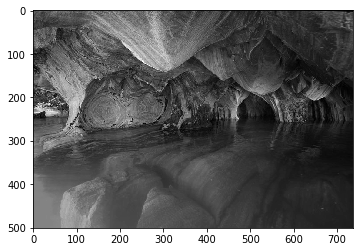

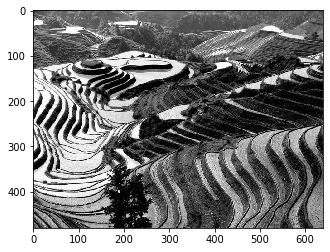

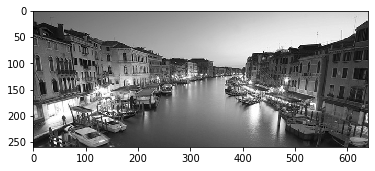

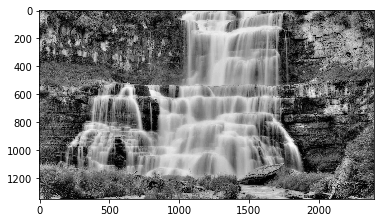

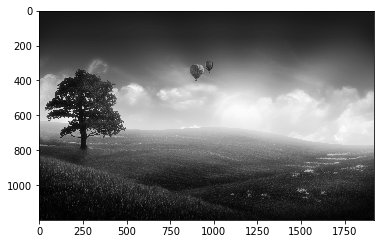

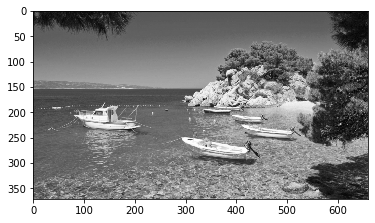

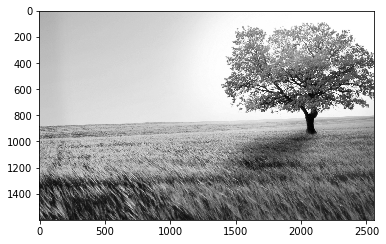

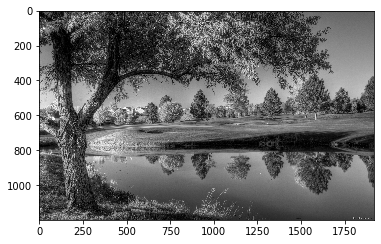

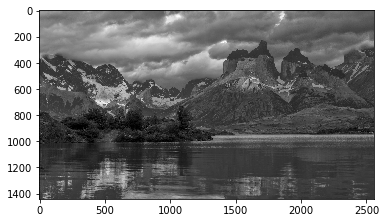

In [5]:
n_images = len(coloured_images)

gray_images = []
for i in range(n_images):
    g_img = convert_to_gray_scale(coloured_images[i])
    gray_images.append(g_img)

# Sample Image plots
for i in range(10):
    plt.imshow(gray_images[i], cmap=plt.get_cmap('gray'))
    plt.show()

#### Part (b)

In [6]:
reconst_images = []
for g in gray_images:
    reconst_images.append(apply_PCA(g))    

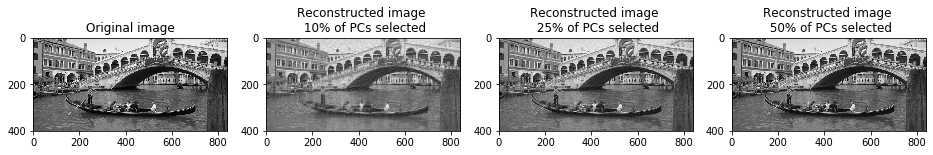

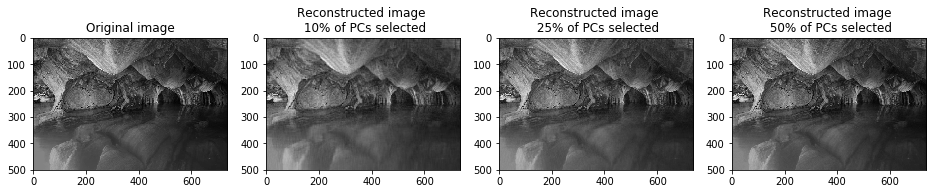

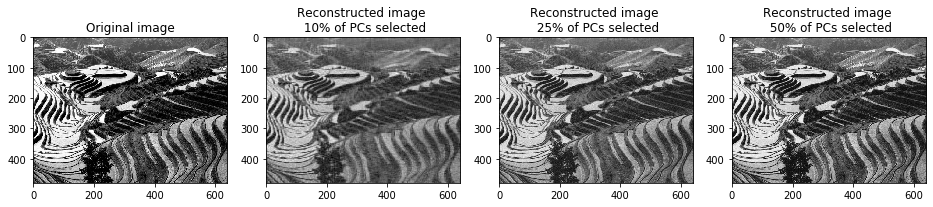

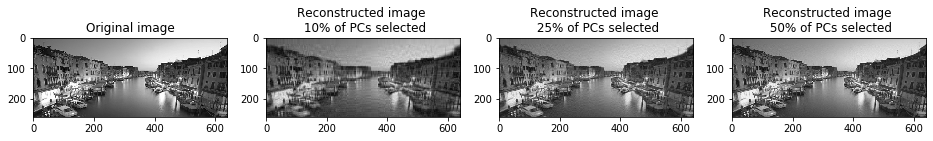

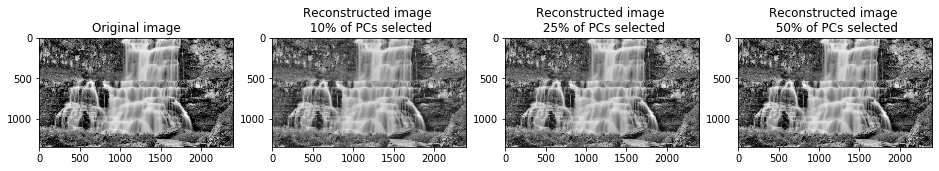

...

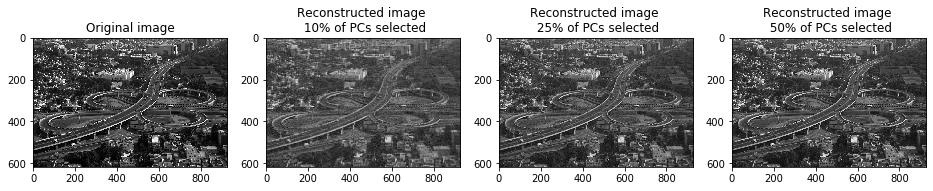

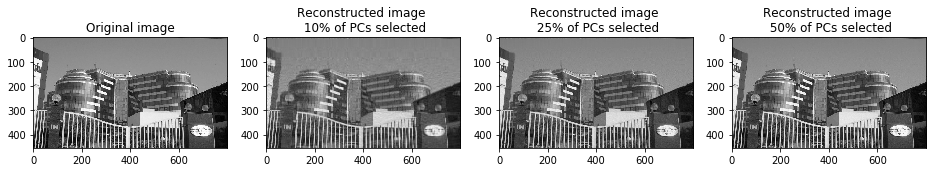

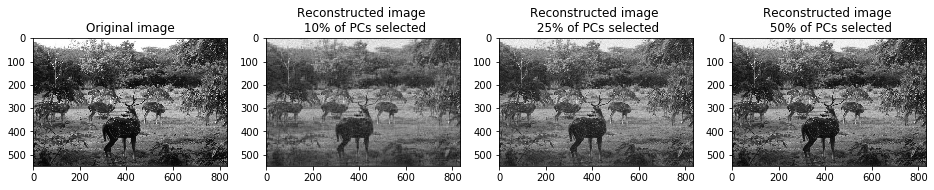

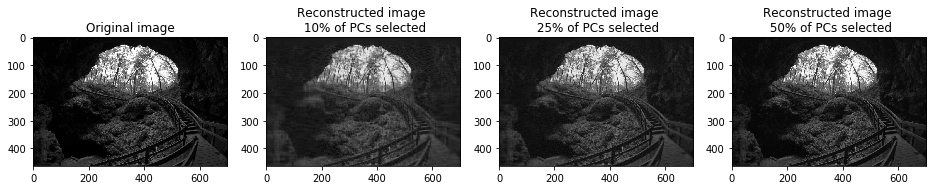

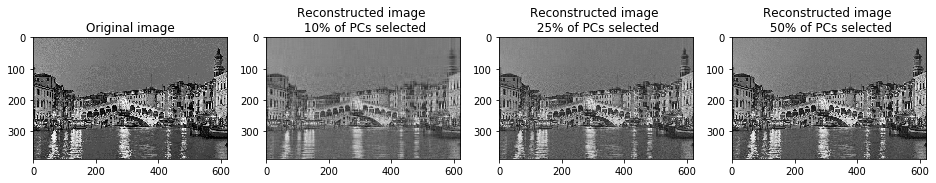

In [7]:
pc_per = [10,25,50]

for i in range(n_images):   
    fig, axes = plt.subplots(nrows=1, ncols=4, figsize=(16, 20))
    
    axes[0].imshow(gray_images[i], cmap=plt.get_cmap('gray'))
    axes[0].set_title('Original image')
    
    for p in range(len(pc_per)):
        axes[p+1].imshow(reconst_images[i][p], cmap=plt.get_cmap('gray'))
        axes[p+1].set_title('Reconstructed image \n {}% of PCs selected'.format(pc_per[p]))


In [8]:
table1 = []

headers = ["Image number"] + list(map(lambda x: "Frobenius norm \n ({}% of PCs selected)".format(x), pc_per))

for i in range(n_images):
    table1.append([i+1, np.linalg.norm((gray_images[i] - reconst_images[i][0]), 'fro'), np.linalg.norm((gray_images[i] - reconst_images[i][1]), 'fro'), np.linalg.norm((gray_images[i] - reconst_images[i][2]), 'fro')])

print(tabulate(table1, headers, tablefmt = 'fancy_grid'))

╒════════════════╤══════════════════════════╤══════════════════════════╤══════════════════════════╕
│   Image number │          Frobenius norm  │          Frobenius norm  │          Frobenius norm  │
│                │    (10% of PCs selected) │    (25% of PCs selected) │    (50% of PCs selected) │
╞════════════════╪══════════════════════════╪══════════════════════════╪══════════════════════════╡
│              1 │                 11172.7  │                  6152.06 │                 2522.65  │
├────────────────┼──────────────────────────┼──────────────────────────┼──────────────────────────┤
│              2 │                  5132.57 │                  2809.67 │                  950.962 │
├────────────────┼──────────────────────────┼──────────────────────────┼──────────────────────────┤
│              3 │                 14190.9  │                  8368.81 │                 3882     │
├────────────────┼──────────────────────────┼──────────────────────────┼──────────────────────────┤


#### Part (c)

In [9]:
random_reconst = []
for i in range(n_images):
    random_reconst.append(apply_PCA(gray_images[i], random = True))

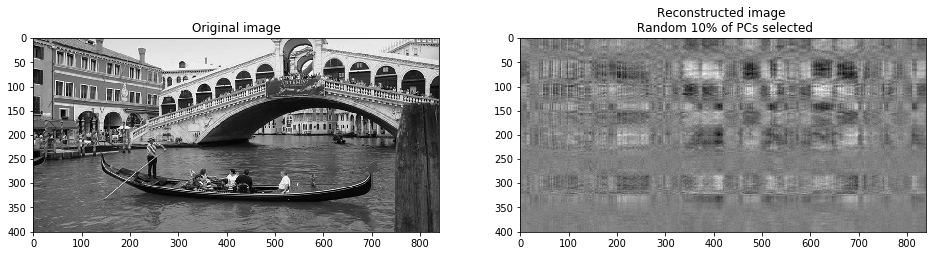

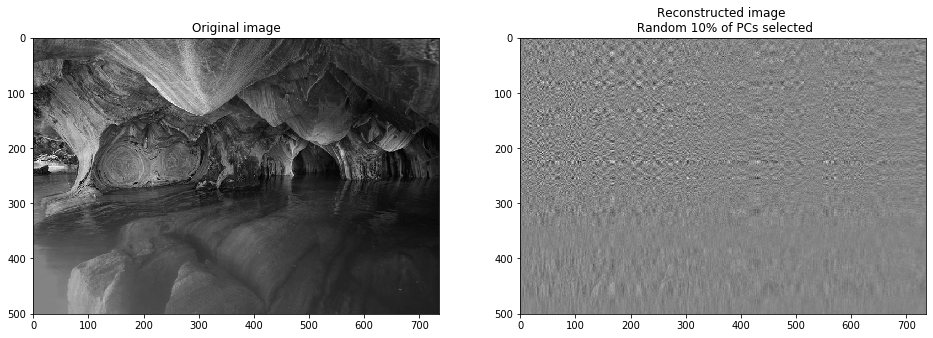

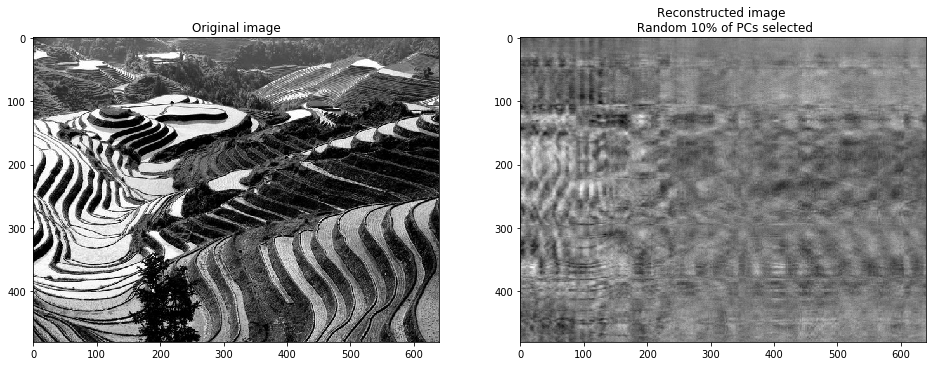

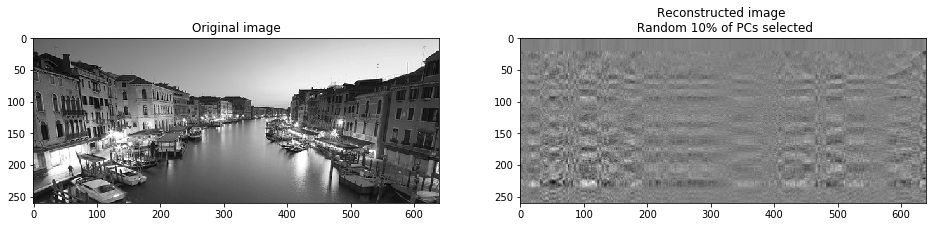

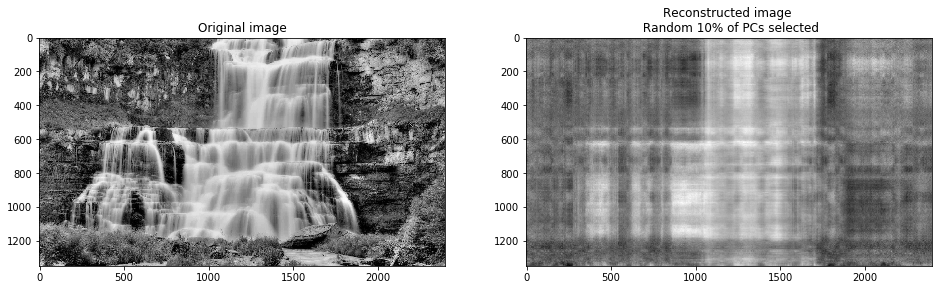

...

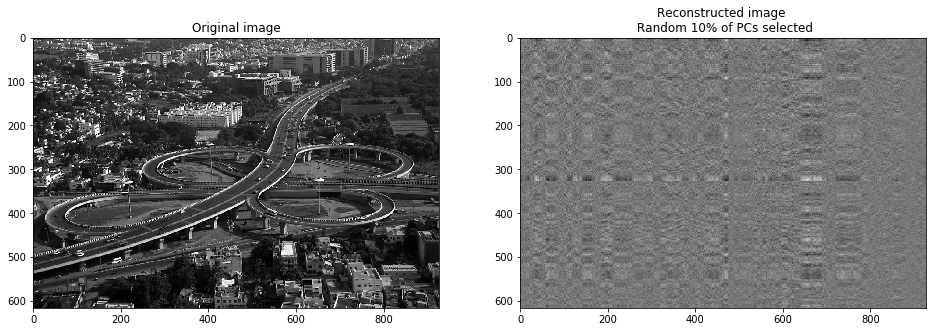

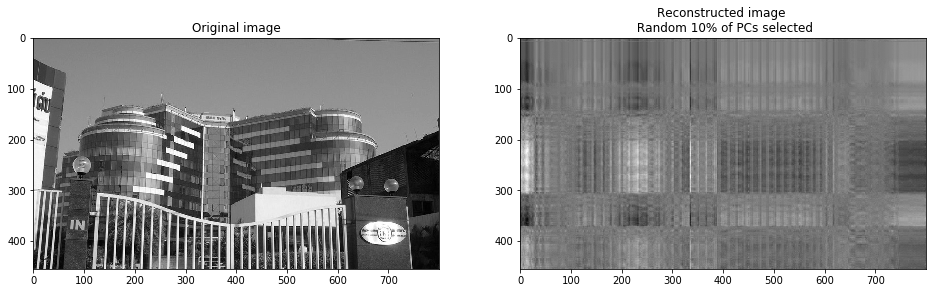

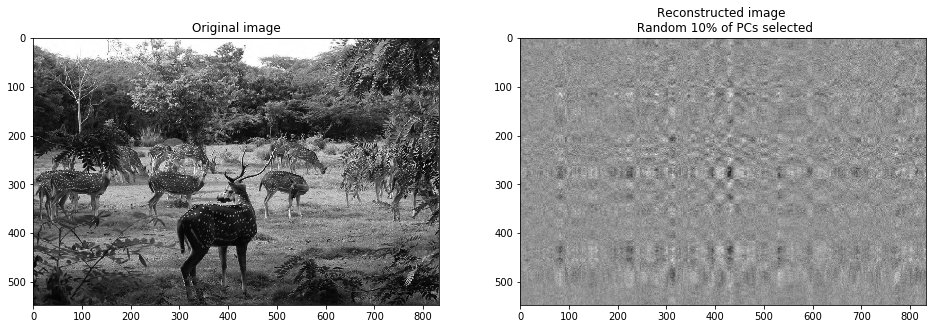

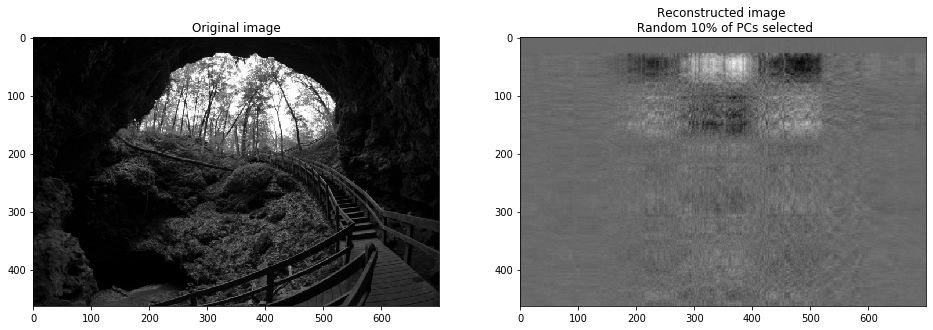

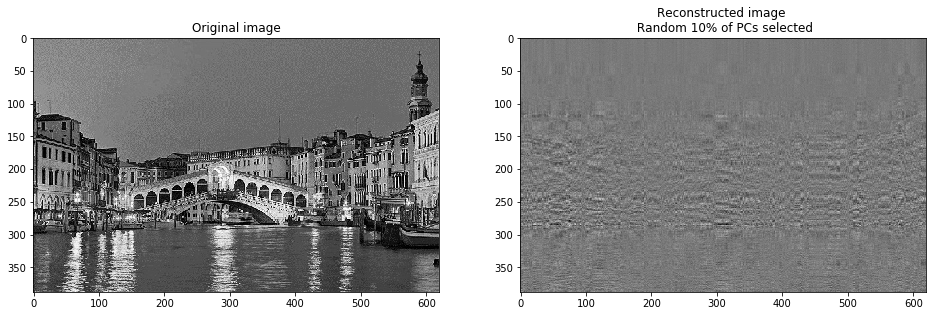

In [10]:
for i in range(n_images):   
    fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(16, 20))
    
    axes[0].imshow(gray_images[i], cmap=plt.get_cmap('gray'))
    axes[0].set_title('Original image')
    axes[1].imshow(random_reconst[i], cmap=plt.get_cmap('gray'))
    axes[1].set_title('Reconstructed image \n Random 10% of PCs selected')


In [11]:
table2 = []

headers = ['Image number', 'Reconstructed image \n Random 10% of PCs selected'] 

for i in range(n_images):
    table2.append([i+1, np.linalg.norm((gray_images[i] - random_reconst[i]), 'fro')])

print(tabulate(table2, headers, tablefmt = 'fancy_grid'))

╒════════════════╤═══════════════════════════════╕
│   Image number │          Reconstructed image  │
│                │    Random 10% of PCs selected │
╞════════════════╪═══════════════════════════════╡
│              1 │                       72927   │
├────────────────┼───────────────────────────────┤
│              2 │                       49112.9 │
├────────────────┼───────────────────────────────┤
│              3 │                       66113.8 │
├────────────────┼───────────────────────────────┤
│              4 │                       54915.3 │
├────────────────┼───────────────────────────────┤
│              5 │                       73370.3 │
├────────────────┼───────────────────────────────┤
│              6 │                      180666   │
├────────────────┼───────────────────────────────┤
│              7 │                       62266.2 │
├────────────────┼───────────────────────────────┤
│              8 │                      354183   │
├────────────────┼─────────────

#### Part (d)

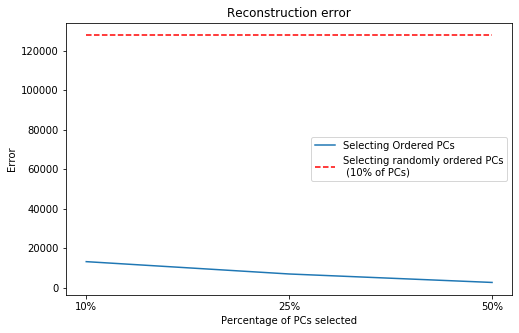

In [12]:
plt.figure(figsize=(8,5))
plt.plot(np.array(['10%','25%', '50%'], dtype = 'object'), np.mean(np.array(table1)[:,1:], axis=0))
plt.plot(np.array(['10%','25%', '50%'], dtype = 'object'), [np.mean(np.array(table2)[:,1:])]*3, '--r')
plt.title('Reconstruction error')
plt.xlabel('Percentage of PCs selected')
plt.ylabel('Error')
plt.legend(['Selecting Ordered PCs', 'Selecting randomly ordered PCs\n (10% of PCs)'])
plt.show()

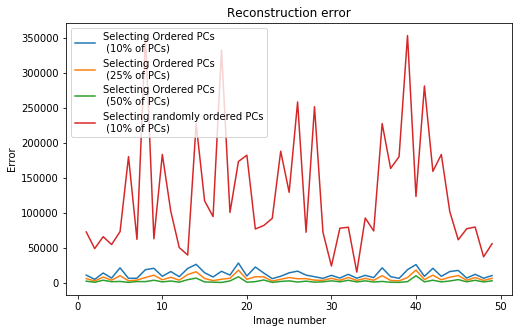

In [15]:
plt.figure(figsize=(8,5))
plt.plot(np.array(table1)[:,0], np.array(table1)[:,1])
plt.plot(np.array(table1)[:,0], np.array(table1)[:,2])
plt.plot(np.array(table1)[:,0], np.array(table1)[:,3])
plt.plot(np.array(table2)[:,0], np.array(table2)[:,1])
plt.title('Reconstruction error')
plt.xlabel('Image number')
plt.ylabel('Error')
plt.legend(['Selecting Ordered PCs\n (10% of PCs)', 'Selecting Ordered PCs\n (25% of PCs)', 'Selecting Ordered PCs\n (50% of PCs)', 'Selecting randomly ordered PCs\n (10% of PCs)'])
plt.show()

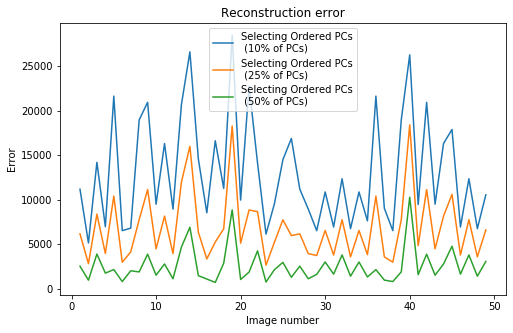

In [16]:
plt.figure(figsize=(8,5))
plt.plot(np.array(table1)[:,0], np.array(table1)[:,1])
plt.plot(np.array(table1)[:,0], np.array(table1)[:,2])
plt.plot(np.array(table1)[:,0], np.array(table1)[:,3])
plt.title('Reconstruction error')
plt.xlabel('Image number')
plt.ylabel('Error')
plt.legend(['Selecting Ordered PCs\n (10% of PCs)', 'Selecting Ordered PCs\n (25% of PCs)', 'Selecting Ordered PCs\n (50% of PCs)'])
plt.show()